# Self Driving Car Engineer Nanodegree

This jupyter notebook has been used to do a firts implementation of each necessary step of the process, and finally, a cleaner set of scripts has been coded with a better organized implementation ([main.py](main.py), [lanes.py](lanes.py) and [camera.py](camera.py)).

The steps of this project are the following:  

* [Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.](#1.-Camera-calibration)
* [Apply the distortion correction to the raw image.](#2.-Apply-the-distortion-correction-to-the-raw-images.)
* [Use color transforms, gradients, etc., to create a thresholded binary image.](#3.-Use-color-transforms,-gradients,-etc.,-to-create-a-thresholded-binary-image.)
* [Apply a perspective transform to rectify binary image ("birds-eye view").](#4.-Apply-a-perspective-transform-to-rectify-binary-image)
* [Detect lane pixels and fit to find lane boundary.](#5.-Detect-lane-pixels-and-fit-to-find-lane-boundary.)
* [Warp the detected lane boundaries back onto the original image.](#6.-Back-to-the-original)
* [Determine curvature of the lane and vehicle position with respect to center.](#7.-Curvature-and-distance)
* [Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.](#8.The-whole-pipeline)

First of all, we import the needed libraries:

In [1]:
# standard libraries
import glob
import pickle

# libraries for video 
from moviepy.editor import VideoFileClip
from IPython.display import HTML

# numeric libraries
import numpy as np
import cv2

# visualization libraries
import matplotlib.pyplot as plt
%matplotlib inline
#%matplotlib qt

## 1. Camera calibration

Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

First of all I define a function that detects the corners in a chessboard image.

In [2]:
def find_corners(img, nx, ny):
    """
    Function that takes an image, number of x and y points,
    """
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    found, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    return found, corners

The image has 9 corners in the x axis, and 6 corners in the y. Here I test the function to see the result:

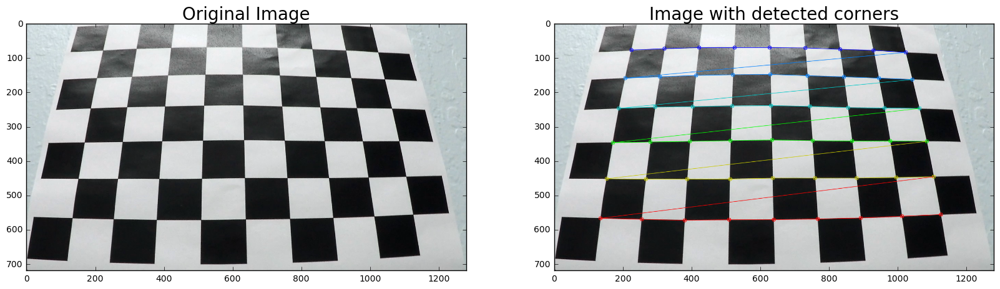

In [3]:
def test_find_corners(filename, nx, ny):
    img = cv2.imread(filename)
    found, corners = find_corners(img, nx, ny)
    # If found, add object points, image points
    if found == True:
        img_corners = cv2.drawChessboardCorners(img, (nx, ny), corners, found)
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
        ax1.imshow(cv2.imread(filename))
        ax1.set_title('Original Image', fontsize=20)
        ax2.imshow(img_corners)
        ax2.set_title('Image with detected corners', fontsize=20);    

nx = 9 
ny = 6 

test_find_corners('camera_cal/calibration3.jpg', nx, ny)

I start by preparing "object points", which will be the (x, y, z) coordinates of the chessboard corners in the world. Here I am assuming the chessboard is fixed on the (x, y) plane at z=0, such that the object points are the same for each calibration image.  Thus, `objp` is just a replicated array of coordinates, and `objpoints` will be appended with a copy of it every time I successfully detect all chessboard corners in a test image.  `imgpoints` will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful chessboard detection.

In [4]:
def get_objectpoints_and_imagepoints(filenames, nx, ny):
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((ny * nx, 3), np.float32)
    objp[:, :2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Step through the list and search for chessboard corners
    for filename in filenames:
        img = cv2.imread(filename)
        ret, corners = find_corners(img, nx, ny)
        if ret:
            objpoints.append(objp)
            imgpoints.append(corners)
    return objpoints, imgpoints

### Camera calibration given object points and image points

I then used the output `objpoints` and `imgpoints` to compute the camera calibration and distortion coefficients using the `cv2.calibrateCamera()` function.

In [5]:
# Make a list of calibration images
filenames = glob.glob('camera_cal/calibration*.jpg')
objpoints, imgpoints = get_objectpoints_and_imagepoints(filenames, nx, ny)

# Trick to get the image size
img = cv2.imread(filenames[0])
img_size = (img.shape[1], img.shape[0])

_, mtx, dist, _, _ = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

Here I test the calibration and distortion coefficients from `cv2.calibrateCamera()` with the chessboard images.

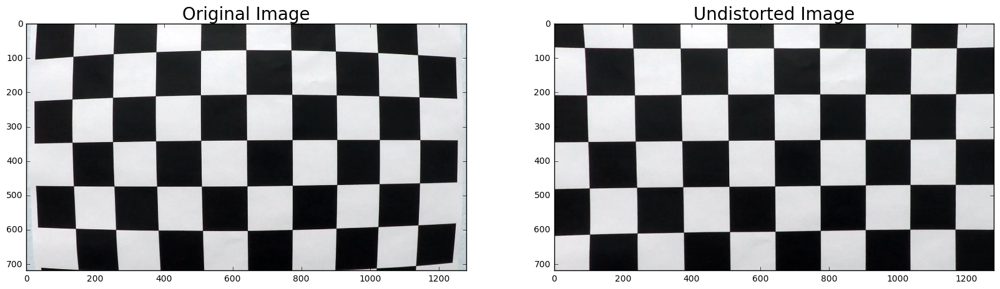

In [6]:
def test_calibration(filename, mtx, dist):
    """ 
    load chessboard images, correct the distortion
    and visualize it
    """
    img = cv2.imread(filename)
    img_corrected = cv2.undistort(img, mtx, dist, None, mtx)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(img_corrected)
    ax2.set_title('Undistorted Image', fontsize=20);

test_calibration('camera_cal/calibration1.jpg', mtx, dist)

## 2. Apply the distortion correction to the raw images.  

With the obtained coefficients, I apply the same test function to the test images: function: 

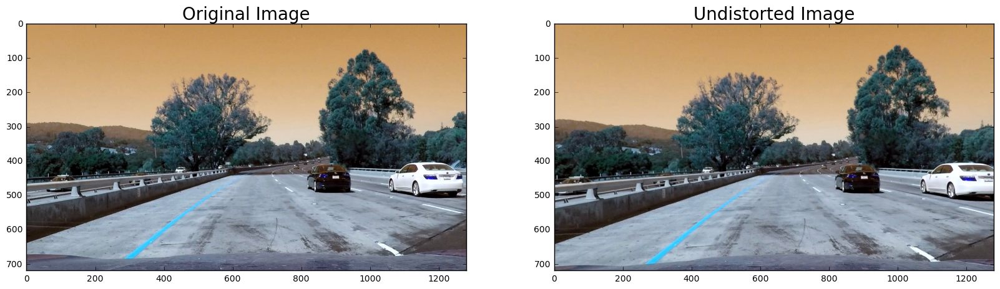

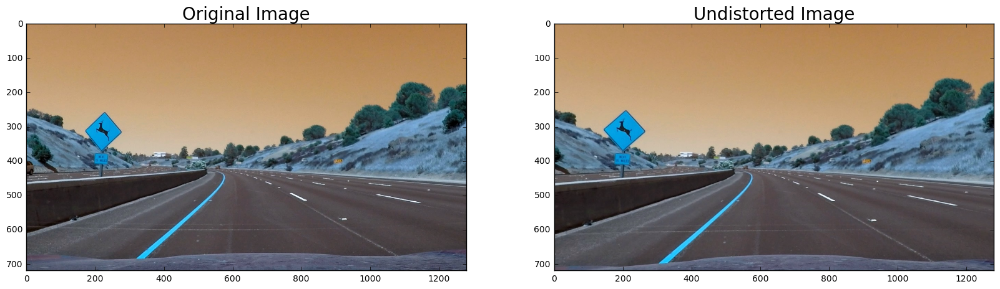

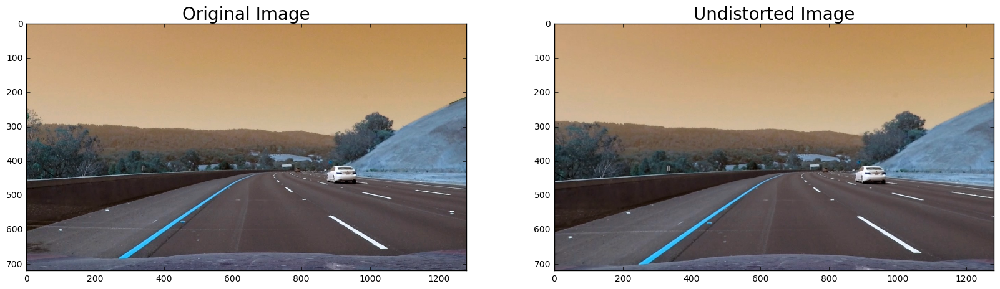

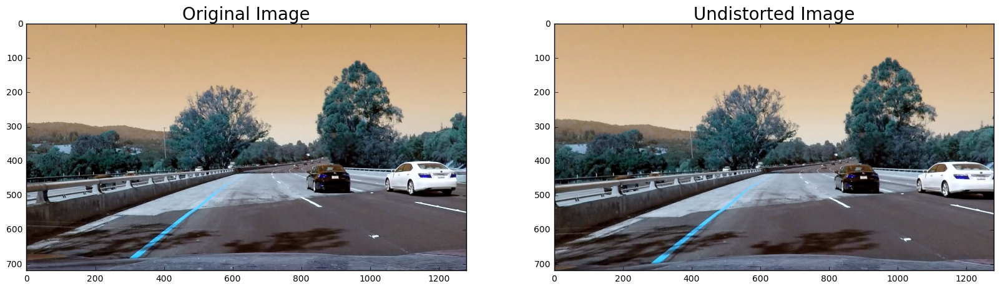

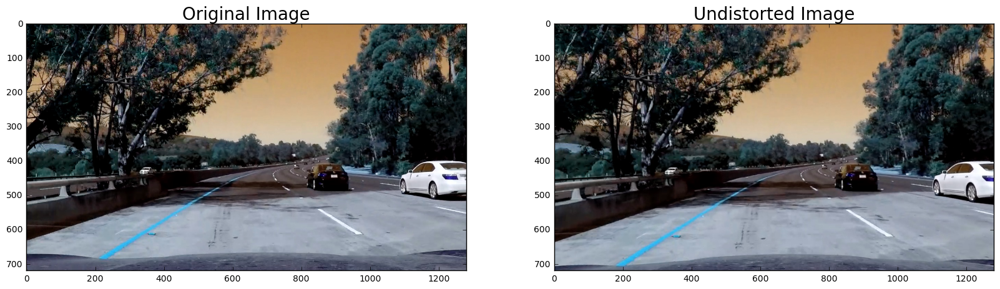

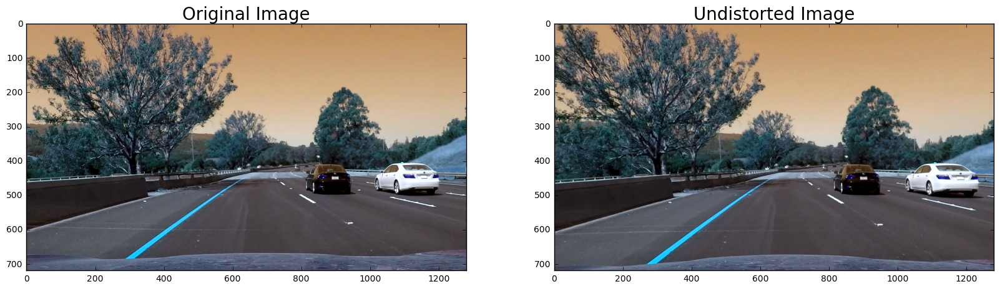

In [7]:
filenames = glob.glob('test_images/test*.jpg')
for f in filenames:
    test_calibration(f, mtx, dist)

## 3. Use color transforms, gradients, etc., to create a thresholded binary image.

First of all, I define a basic function to convert an image from BGR to grayscale. This function is used along the project.

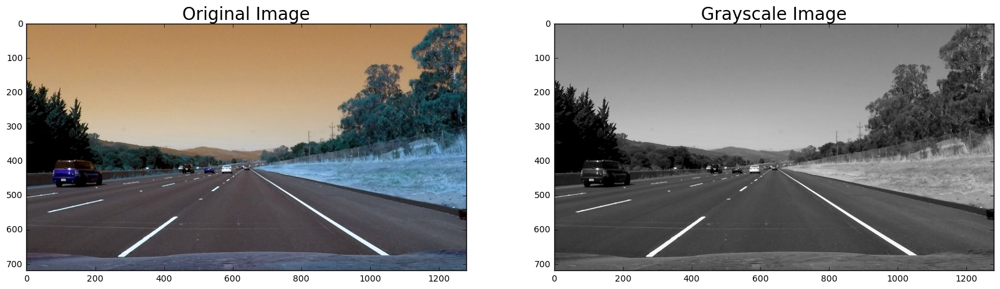

In [8]:
def grayscale(img):
    """
    Applies the Grayscale transform.
    This will return an image with only one color channel.
    NOTE: to see the returned image as grayscale
    you should call plt.imshow(gray, cmap='gray')
    """
    return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

def test_grayscale(filename):
    img = cv2.imread(filename)
    grey = grayscale(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(grey, cmap='gray')
    ax2.set_title('Grayscale Image', fontsize=20);

test_grayscale('test_images/straight_lines2.jpg')

Another useful function is the used to applt a binary mask on top of a grayscaled image

In [9]:
def binary_threshold(img, thresh):
    """
    Function to create a binary mask where thresholds are met.

    1. Apply the threshold, zeros otherwise.
    2. Return the binary image.
    """
    binary = np.zeros_like(img)
    binary[(img >= thresh[0]) & (img <= thresh[1])] = 1
    return binary

Again, to test the function I create a test function and I tested using the same image and different thresholds, to see which one performs better.

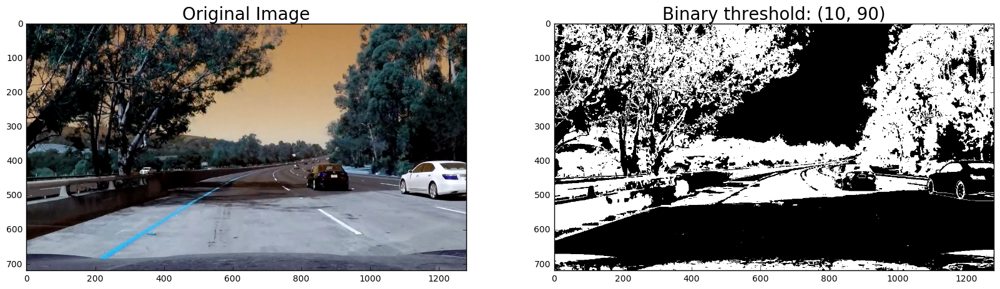

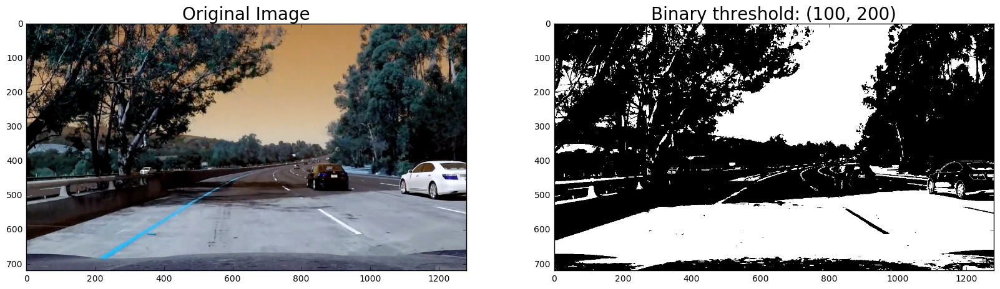

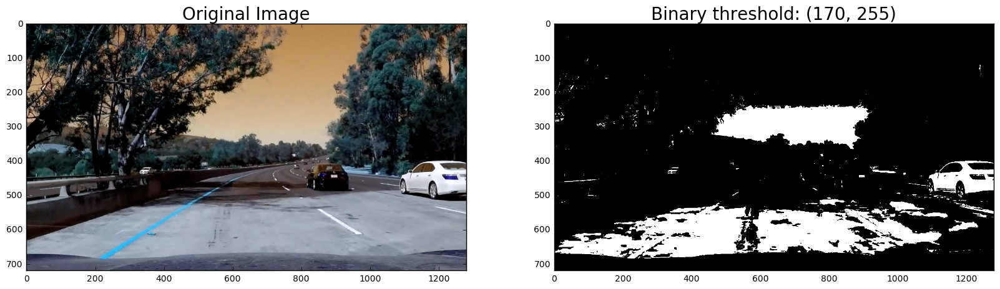

In [10]:
def test_binary_threshold(filename, thresh=(10, 150)):
    img = cv2.imread(filename)
    gray = grayscale(img)
    binary = binary_threshold(gray, thresh=thresh)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(binary, cmap='gray')
    ax2.set_title('Binary threshold: ({}, {})'.format(thresh[0], thresh[1]), fontsize=20);

test_binary_threshold('test_images/test5.jpg', thresh=(10, 90))
test_binary_threshold('test_images/test5.jpg', thresh=(100, 200))
test_binary_threshold('test_images/test5.jpg', thresh=(170, 255))

Another function used in this step is the gradient magnitude, defined below. Here we use the same methodology, defining the function and performing few tests to find a good threshold value.

In [11]:
def mag_threshold(img, sobel_kernel=3, thresh=(0, 255)):
    """
    Gradient magnitude
    ------------------
    Function to threshold an image for a given gradient magnitude range.

    The magnitude, or absolute value of the gradient is just the square 
    root of the squares of the individual x and y gradients; 
    for a gradient in both the x and y directions, the magnitude 
    is the square root of the sum of the squares.
    
    1. Take both Sobel x and y gradients.
    2. Calculate the gradient magnitude.
    3. Scale to 8-bit (0 - 255) and convert to type = np.uint8
    4. Return the binary thresholded image.
    """
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    return binary_threshold(gradmag, thresh)

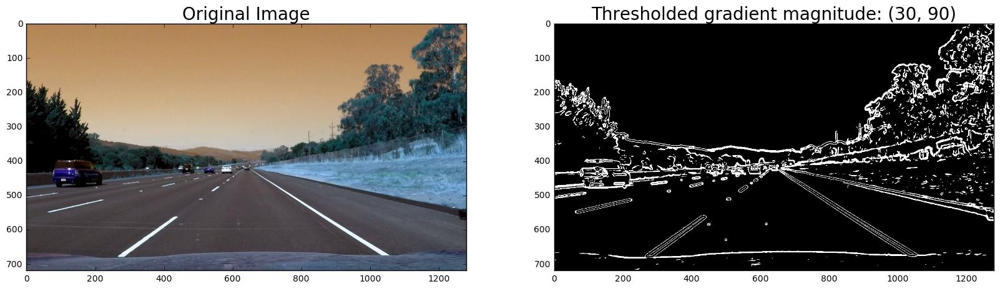

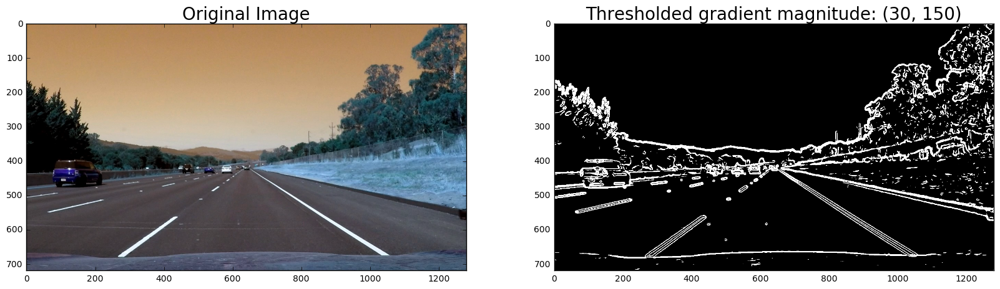

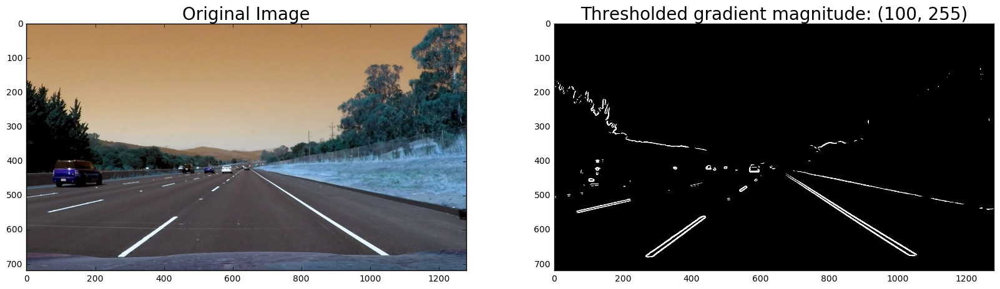

In [12]:
def test_mag_threshold(filename, thresh=(30, 150)):
    img = cv2.imread(filename)
    gray = grayscale(img)
    binary = mag_threshold(gray, sobel_kernel=15, thresh=thresh)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(binary, cmap='gray')
    ax2.set_title('Thresholded gradient magnitude: ({}, {})'.format(thresh[0], thresh[1]), fontsize=20);

test_mag_threshold('test_images/straight_lines2.jpg', thresh=(30, 90))
test_mag_threshold('test_images/straight_lines2.jpg', thresh=(30, 150))
test_mag_threshold('test_images/straight_lines2.jpg', thresh=(100, 255))

The gradient threshold method is also used, and here I define the used function and its tests with different thresholds.

In [13]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    """
    Gradient direction threshold
    ------------------------------
    Function to threshold an image for a given range and Sobel kernel
    
    The direction of the gradient is simply the arctangent of the y-gradient 
    divided by the x-gradient. Each pixel of the resulting image contains a 
    value for the angle of the gradient away from horizontal in units of radians, 
    covering a range of −π/2 to π/2. An orientation of 0 implies a horizontal 
    line and orientations of +/−π/2 imply vertical lines.
    
    1. Take both Sobel x and y gradients.
    2. Take the absolute value of the gradient direction.
    3. Return the binary thresholded image.
    """
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    return binary_threshold(absgraddir, thresh)

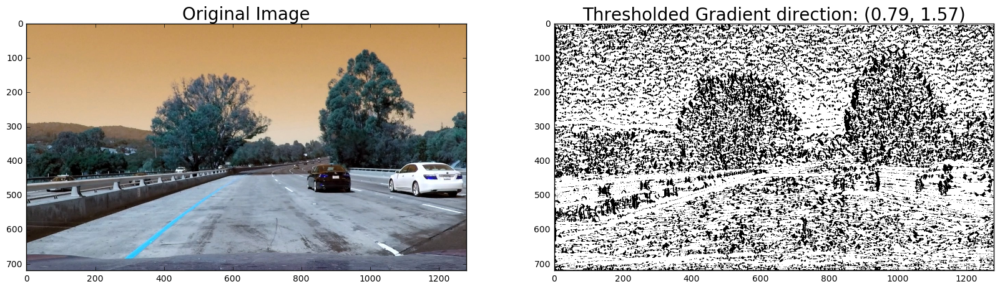

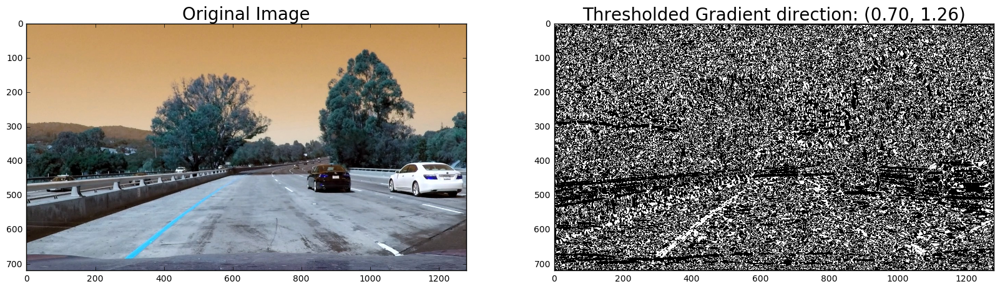

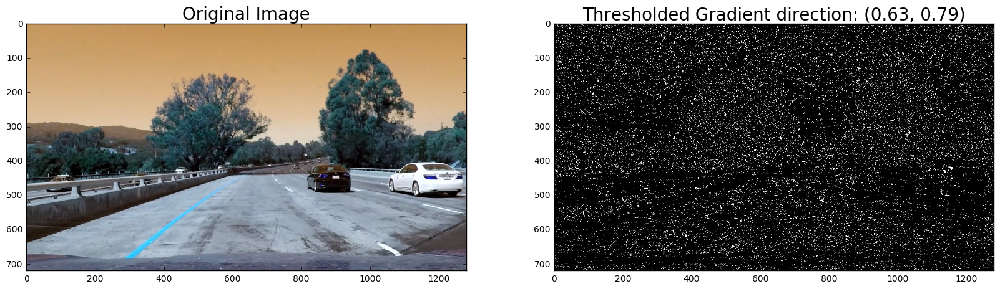

In [14]:
def test_dir_threshold(filename, thresh):
    img = cv2.imread(filename)
    gray = grayscale(img)
    binary = dir_threshold(gray, sobel_kernel=15, thresh=thresh)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(binary, cmap='gray')
    ax2.set_title('Thresholded Gradient direction: ({:.2f}, {:.2f})'.format(thresh[0], thresh[1]), fontsize=20);

test_dir_threshold('test_images/test1.jpg', thresh=(np.pi/4, np.pi/2))
test_dir_threshold('test_images/test1.jpg', thresh=(np.pi/4.5, np.pi/2.5))
test_dir_threshold('test_images/test1.jpg', thresh=(np.pi/5, np.pi/4))

The last threshold method used in this step is the color one. We convert the image to the HLS colorspace and apply the binary threshold on the S channel.

In [15]:
def hls_threshold(img, thresh=(0, 255)):
    """
    Color space threshold
    ---------------------
    Function to threshold the S-channel of an image.
    1. Convert from RGB to HLS.
    2. Extract the S-Channel.
    4. Return the binary thresholded image.
    """
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    return binary_threshold(s_channel, thresh)

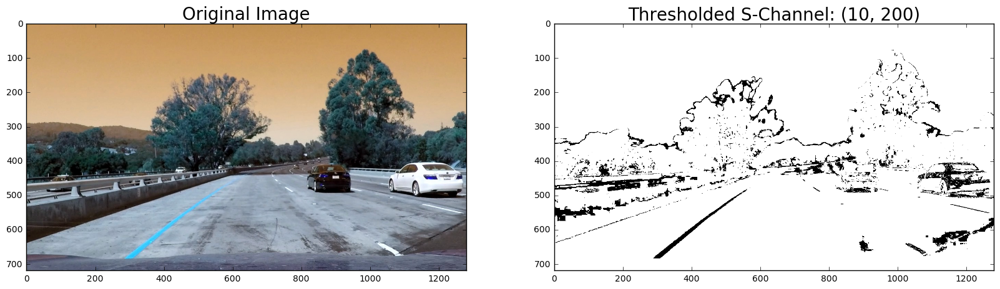

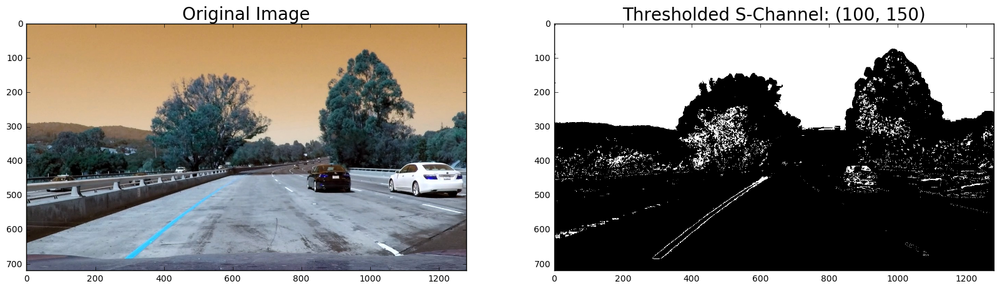

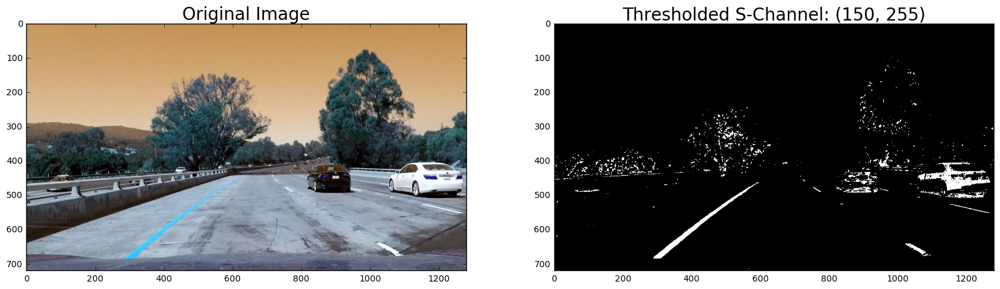

In [16]:
def test_hls_threshold(filename, thresh=(175, 250)):
    img = cv2.imread(filename)
    binary = hls_threshold(img, thresh=thresh)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(binary, cmap='gray')
    ax2.set_title('Thresholded S-Channel: ({}, {})'.format(thresh[0], thresh[1]), fontsize=20);

test_hls_threshold('test_images/test1.jpg', thresh=(10, 200))
test_hls_threshold('test_images/test1.jpg', thresh=(100, 150))
test_hls_threshold('test_images/test1.jpg', thresh=(150, 255))

At this point, I can combine thresholds:
```
                  Grayscale -> Magnitude -> Direction
    Original ->                                         --> Combined
                                HLS
```

In [17]:
def multi_thresholds(img):
    """
    Combine thresholds
    """
    gray = grayscale(img)
    magnitude = mag_threshold(gray, sobel_kernel=9, thresh=(100, 255))
    direction = dir_threshold(gray, sobel_kernel=15, thresh=(0.7,1.3))
    combined_binary = np.zeros_like(direction)
    combined_binary[((magnitude == 1) & (direction == 1))] = 1
    hls = hls_threshold(img, thresh=(150, 255))
    combined = np.zeros_like(combined_binary)
    combined[(hls == 1) | (combined_binary == 1)] = 1
    return combined

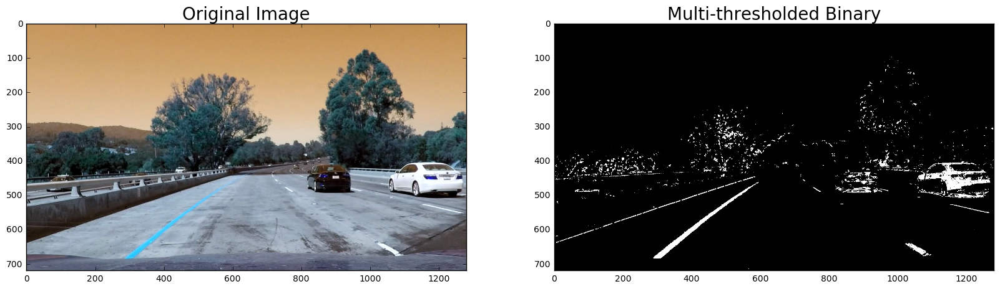

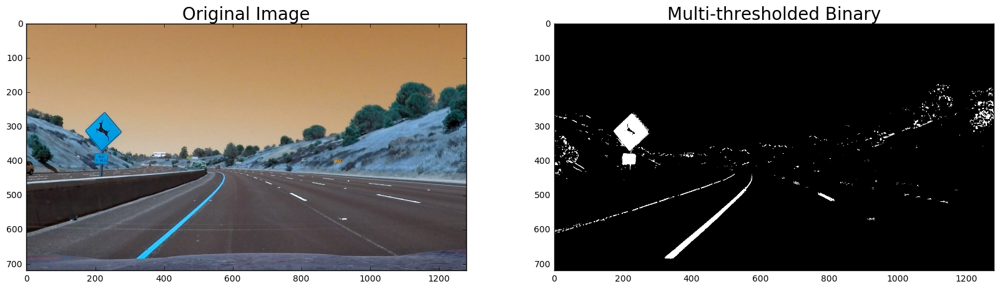

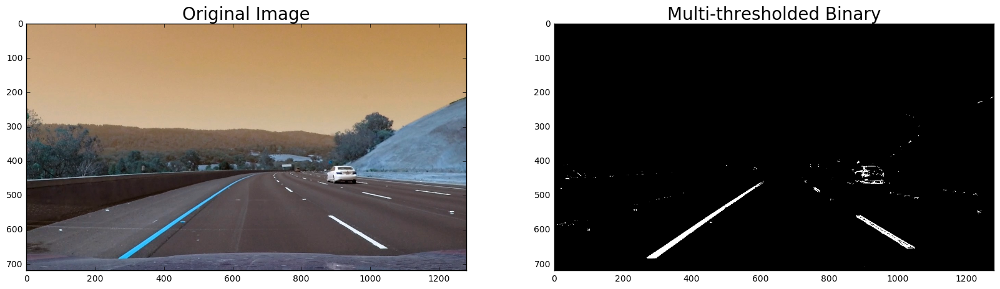

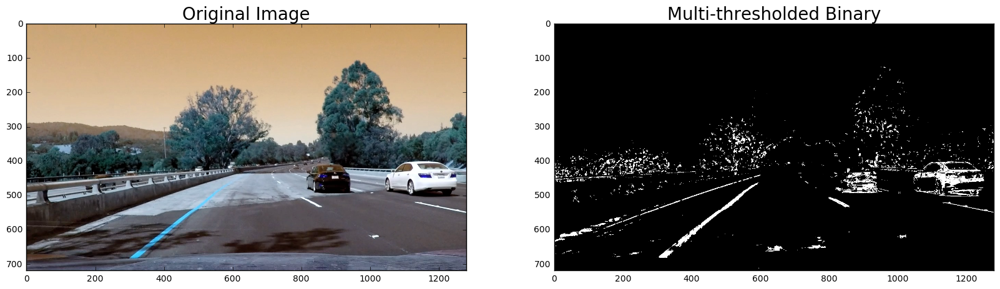

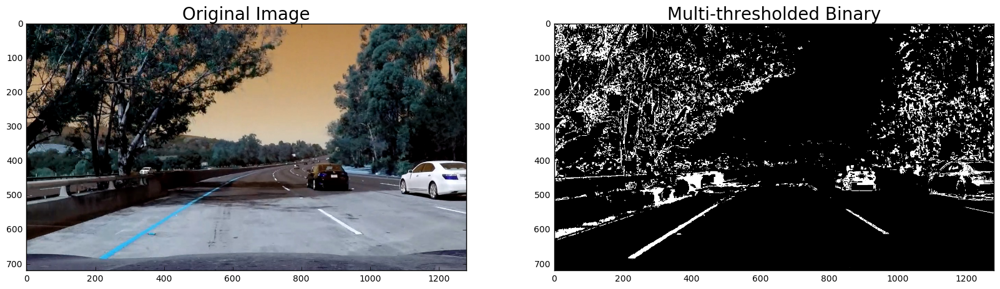

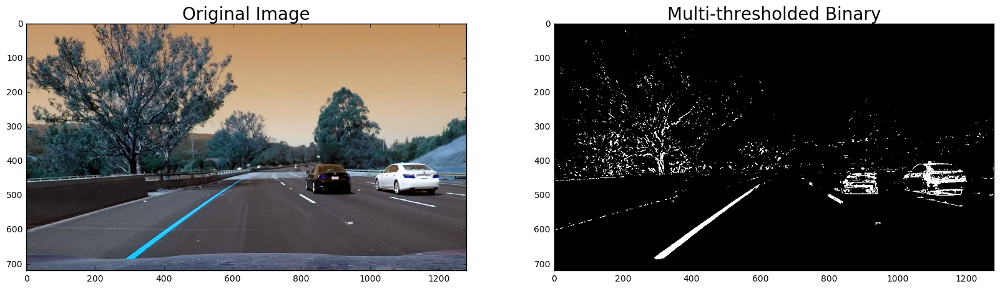

In [18]:
def test_multi_threshold(filename):
    img = cv2.imread(filename)
    binary = multi_thresholds(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(binary, cmap='gray')
    ax2.set_title('Multi-thresholded Binary', fontsize=20);

for f in filenames:
    test_multi_threshold(f)

### Select region of interest

Here I defined a function to define a region of interest and mask the image with that ROI, but finally I didn't use it. I leave it here because it's useful to visualize the used polygon in the following steps:

```
vertices = np.float32([[240,719], [579,450], [712,450], [1165,719]])
```

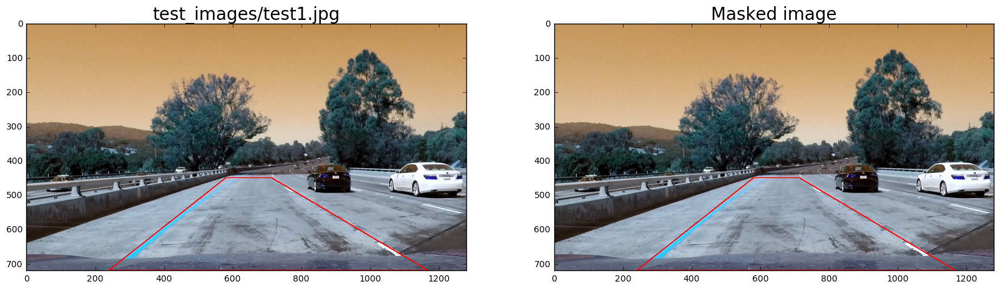

In [19]:
def region_of_interest(img, vertices):
    """
    Apply a mask on the region of interest
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    
    1. defining a blank mask to start with
    2. defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    3. filling pixels inside the polygon defined by "vertices" with the fill color    
    4. returning the image only where mask pixels are nonzero
    """    
    mask = np.zeros_like(img)   
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255, ) * channel_count
    else:
        ignore_mask_color = 1
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    masked_image = cv2.bitwise_and(img, mask)
    masked_image = cv2.polylines(img,[vertices],True,(255,0,0), 2)
    return masked_image

def test_region_of_interest(filename):
    img = cv2.imread(filename)
    img_x = img.shape[1]
    img_y = img.shape[0]
    vertices = np.array([[[240,719], [579,450], [712,450],[1165,719]]])
    img_masked = region_of_interest(img, vertices)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(img)
    ax1.set_title(filename, fontsize=20)
    ax2.imshow(img_masked, cmap='gray')
    ax2.set_title('Masked image', fontsize=20);

test_region_of_interest(filenames[0])

## 4. Apply a perspective transform to rectify binary image

The code for my perspective transform includes a function called `warper()`, which appears below.  The `warper()` function takes as inputs an image, as well as the matrix and distortion coefficients. The source (`src`) and destination (`dst`) points to apply the `cv2.getPerspectiveTransform()` are hardcoded inside the function.

```
    src = np.float32([[240,719], [579,450], [712,450], [1165,719]])
    dst = np.float32([[300,719], [300,0], [900,0], [900,719]])
```

I verified that my perspective transform was working as expected by drawing the `src` and `dst` points onto the test images and its warped counterpart to verify that the lines appear parallel in the warped image.

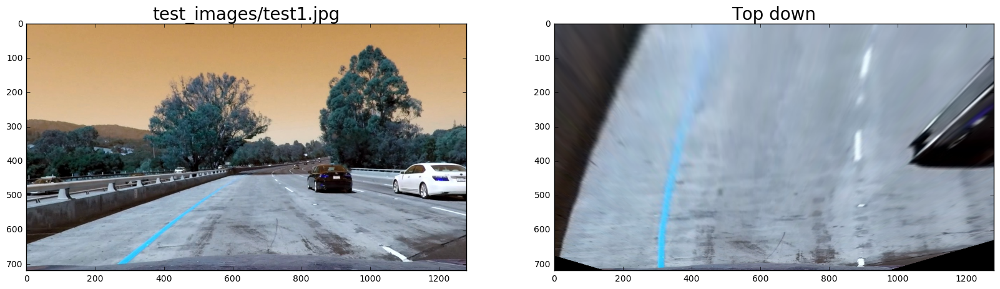

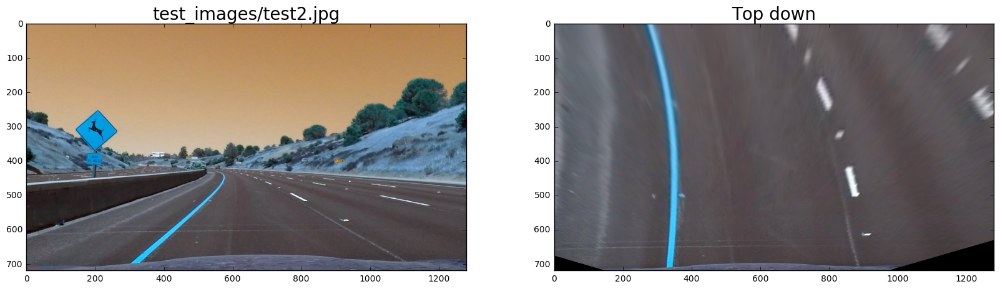

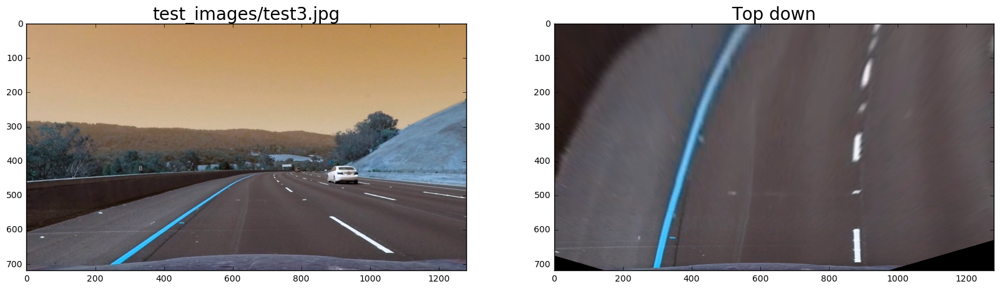

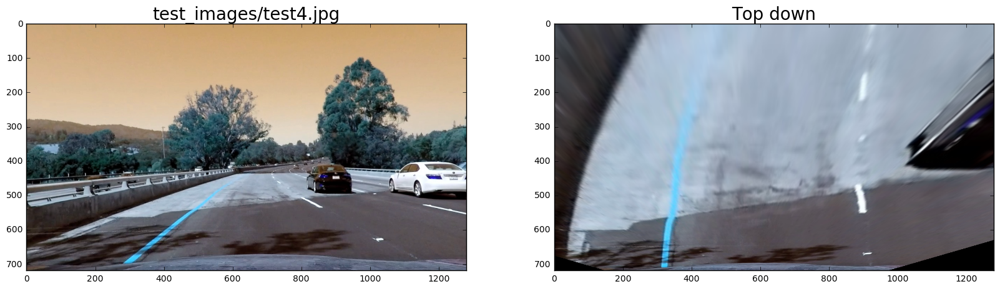

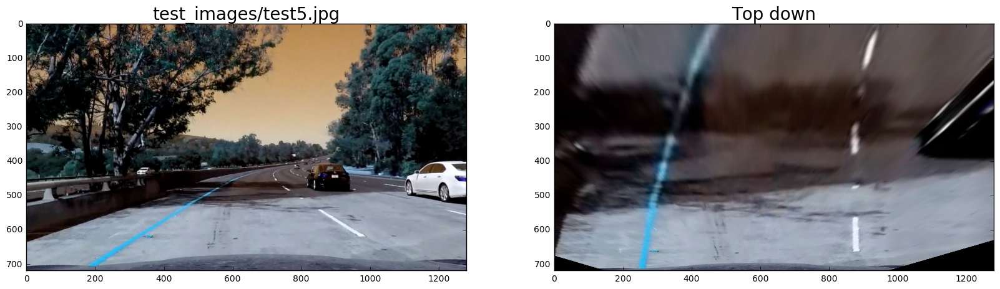

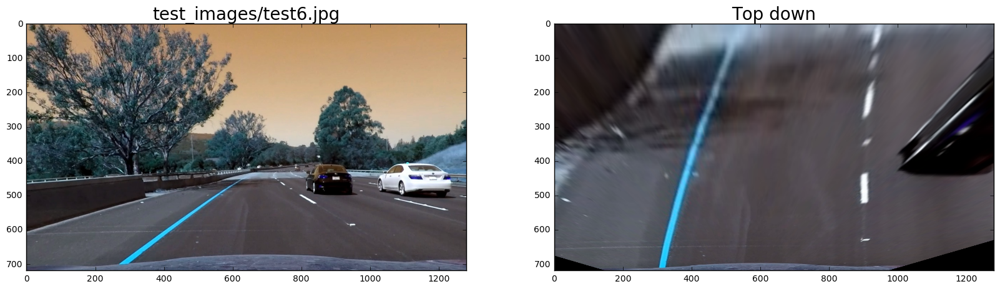

In [20]:
def warp(img, mtx, dist):
    """
    Define a perspective transform function.
    1. Define the src and dst polygons to apply the transformation.
    2. Calculate the perspective transform matrix, M.
    3. Compute the inverse also by swapping the input parameters, Minv.
    4. Warp the image using OpenCV warpPerspective().
    5. Return the resulting image and matrix.
    """
    src = np.float32([[240,719], [579,450], [712,450], [1165,719]])
    dst = np.float32([[300,719], [300,0], [900,0], [900,719]])
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped, M, Minv


def test_warp(filename):
    img = cv2.imread(filename)    
    img_undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    top_down, M, Minv = warp(img_undistorted, mtx, dist)
    f, ((ax1, ax2)) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(img_undistorted)
    ax1.set_title(filename, fontsize=20)
    ax2.imshow(top_down)
    ax2.set_title('Top down', fontsize=20);
    
for f in filenames:
    test_warp(f)

## 5. Detect lane pixels and fit to find lane boundary.

To test the lante detection, I wrote a function that warps an image using the matrix and distortion coefficients, then it applies the different thresholds, and finally it prints the binary image, with an histogram overlay on top of it, to see the peaks visually.

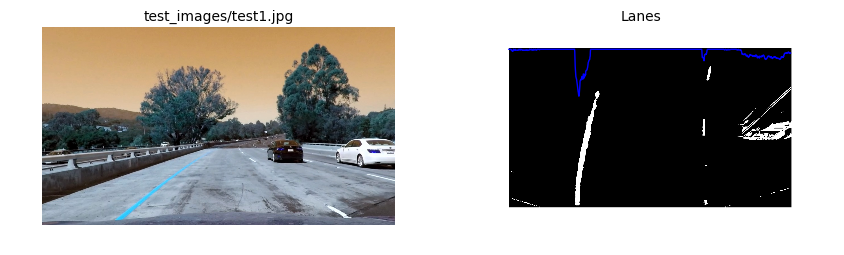

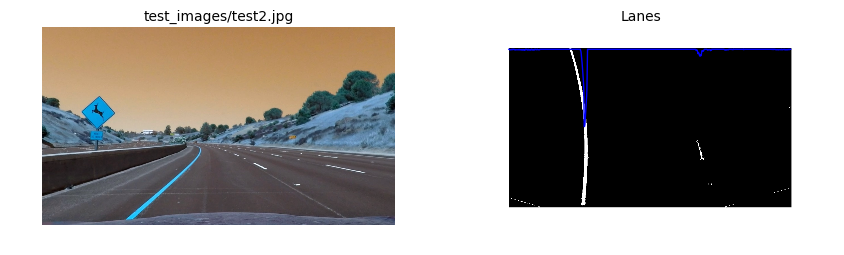

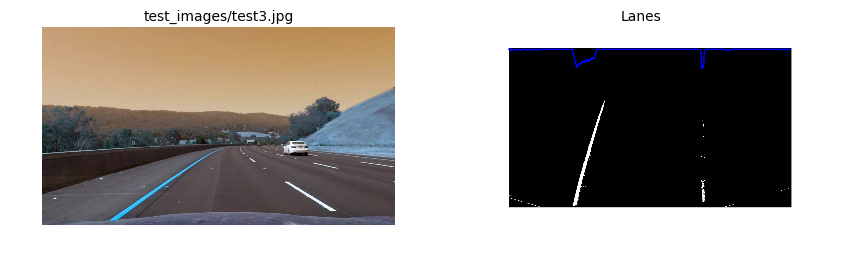

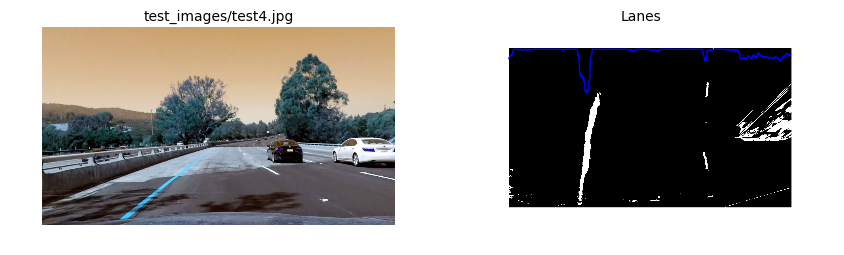

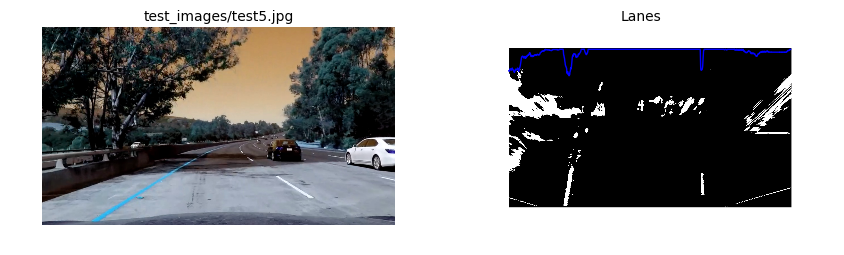

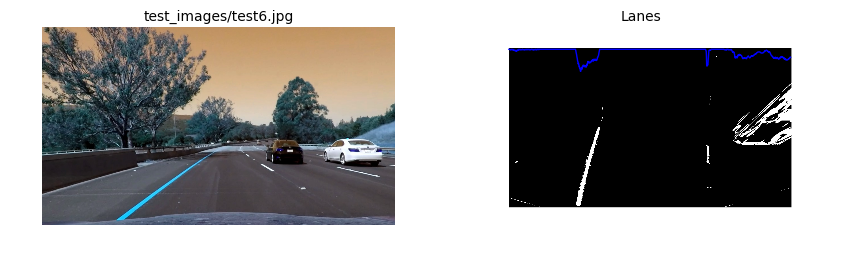

In [21]:
def detect_lane(filename):
    img = cv2.imread(filename)    
    img_undist = cv2.undistort(img, mtx, dist, None, mtx)
    img_warp, M, Minv = warp(img_undist, mtx, dist)
    img_binary = multi_thresholds(img_warp)
    return img, img_undist, img_binary, Minv

def test_detect_lane(filename):
    _, undist, binary_warped, _ = detect_lane(filename)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))
    ax1.axis('off')
    ax2.axis('off')
    ax1.imshow(undist)
    ax1.set_title(filename, fontsize=10)
    ax2.imshow(binary_warped, cmap='gray')
    ax2.set_title('Lanes', fontsize=10)
    
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    plt.plot(histogram)
    
for f in filenames:
    test_detect_lane(f)

At this point, I was able to write a function that using the previous information, is able to find a second order polynomial that should match the masked lanes.

In [22]:
def find_lane_points(binary_warped):
    """
    Find Lane Points.
    1. Take a histogram of the bottom half of the image
    2. Find the peak of the left and right halves of the histogram
    3. Define sliding windows
    4. Step through the windows one by one
    5. Identify candidate pixels and append them to the indices list. 
       If good value, recenter next window.
    6. Fit a second order polynomial with all the indices.
    """
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    window_height = np.int(binary_warped.shape[0]/nwindows)

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return leftx, lefty, left_fit, rightx, righty, right_fit

Here I test the `find_lane_points` function with the test images. To see if the results are good, I overlay the polynomial on top of the binary warped image (birds' eye)

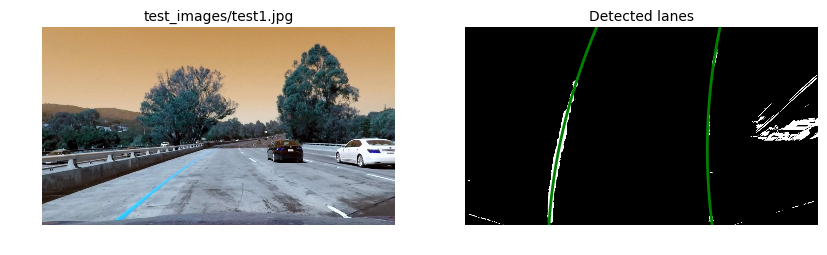

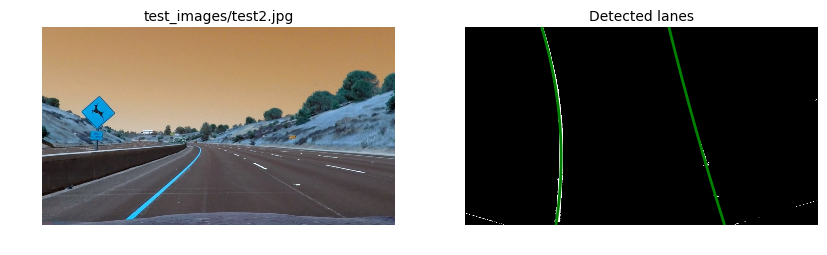

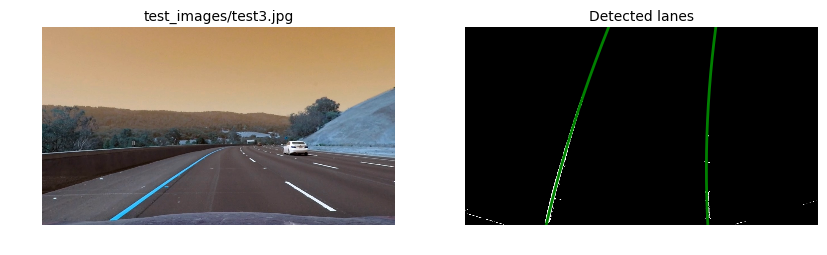

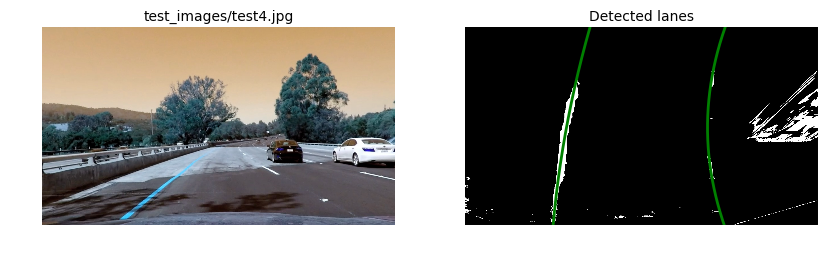

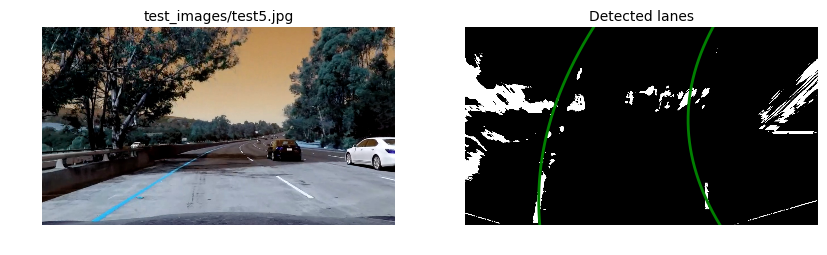

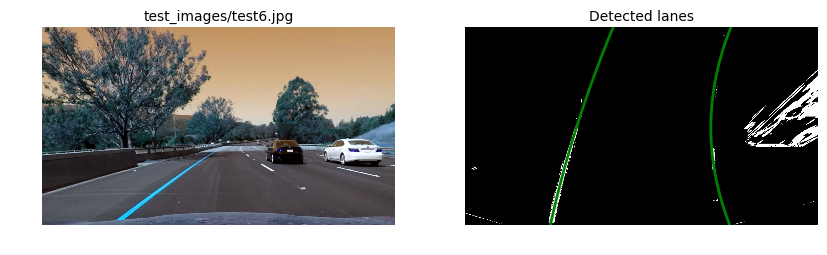

In [23]:
def test_find_lane_points(filename):
    _, undist, binary_warped, _ = detect_lane(filename)
    leftx, lefty, left_fit, rightx, righty, right_fit = find_lane_points(binary_warped)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))
    ax1.axis('off')
    ax2.axis('off')
    
    ax1.imshow(undist)
    ax1.set_title(filename, fontsize=10)
    ax2.imshow(binary_warped, cmap='gray')
    ax2.set_title('Detected lanes', fontsize=10)

    plt.imshow(binary_warped, cmap='gray')
    plt.plot(left_fitx, ploty, color='green', linewidth=2)
    plt.plot(right_fitx, ploty, color='green', linewidth=2)
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    
for f in filenames:
    test_find_lane_points(f)

## 6. Back to the original

The last function related to the detection, is to warp the detected lane boundaries back onto the original image. This is done with the `cast_lane` function, and is also tested.

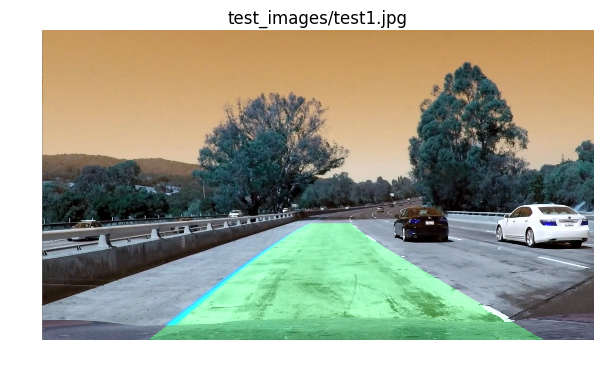

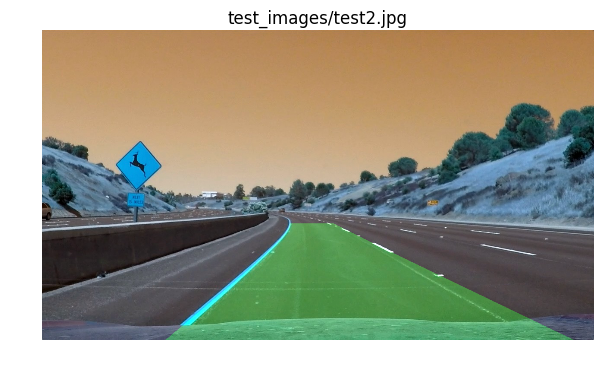

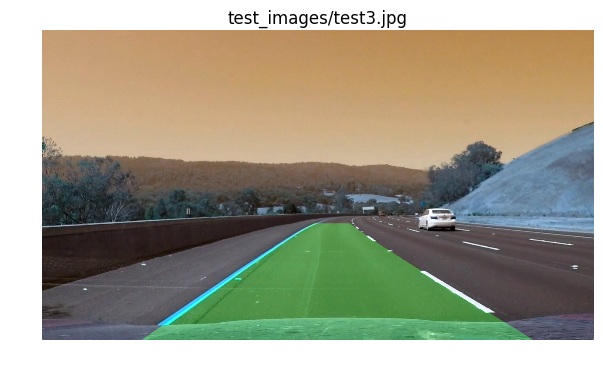

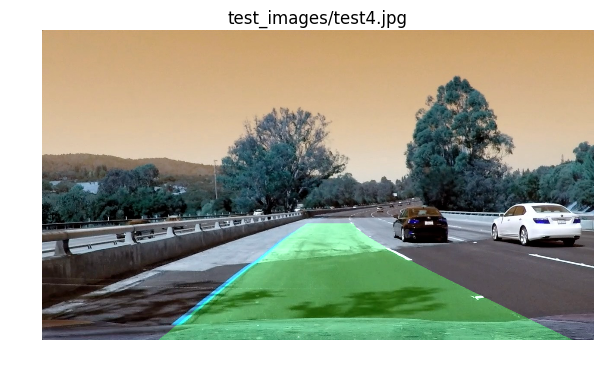

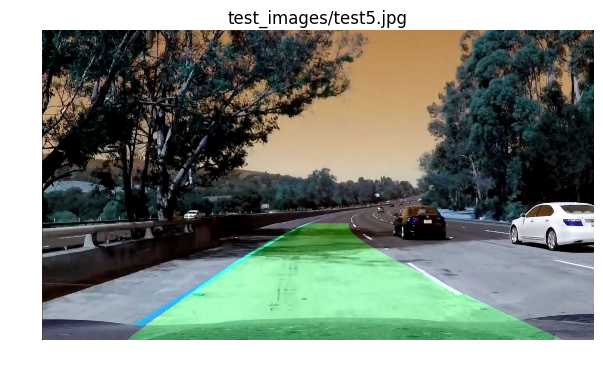

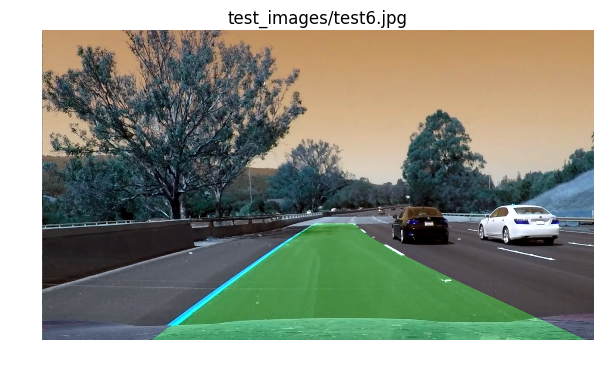

In [24]:
def cast_lane(img, Minv, left_fit, right_fit):
    """
    Cast the fitted line back to the original image
    
    1. Generate x and y values for plotting
    2. Recast the x and y points into usable format for cv2.fillPoly()
    3. Draw the lane onto the warped blank image
    4. Warp the blank back to original image space using inverse perspective matrix (Minv)
    5. Combine the result with the original image
    """
    color_warp = np.zeros_like(img).astype(np.uint8)
    
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0]))     
    img_combined = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
    return img_combined

def test_cast_lane(filename):
    img, undist, binary_warped, Minv = detect_lane(filename)
    leftx, lefty, left_fit, rightx, righty, right_fit = find_lane_points(binary_warped)
        
    img_lane = cast_lane(img, Minv, left_fit, right_fit)

    f, ax1 = plt.subplots(1, 1, figsize=(10, 4))
    ax1.axis('off')
    
    ax1.imshow(undist)
    ax1.set_title(filename, fontsize=10)

    plt.title(filename)
    plt.imshow(img_lane);
    
for f in filenames:
    test_cast_lane(f)

## 7. Curvature and distance

Two more functions are needed to complete the project. One to calculate the lane curvature and another one to find the vehicle position. Both functions are defined below (and tested).

In [25]:
def get_curvature(fit_model, ploty):
    """
    Caculate lane curvature
    -----------------------
    Function to calculate the radius of curvature based on pixel values, 
    so the radius we are reporting is in pixel space, 
    which is not the same as real world space. 
    """
    y_eval = np.max(ploty)
    radius = ((1 + (2 * fit_model[0] * y_eval + fit_model[1])**2)**1.5) / np.absolute(2 * fit_model[0])
    return radius

def test_get_curvature(filename):
    img, undist, binary_warped, Minv = detect_lane(filename)
    leftx, lefty, left_fit, rightx, righty, right_fit = find_lane_points(binary_warped)
    curv_left = get_curvature(left_fit, lefty)
    curv_right = get_curvature(right_fit, righty)
    print(filename, "Left radius: {:.1f}m, Right radius: {:.1f}m".format(curv_left, curv_right))
    
for f in filenames:
    test_get_curvature(f)

test_images/test1.jpg Left radius: 2017.3m, Right radius: 2177.7m
test_images/test2.jpg Left radius: 1644.6m, Right radius: 11316.3m
test_images/test3.jpg Left radius: 4615.1m, Right radius: 3910.4m
test_images/test4.jpg Left radius: 3705.1m, Right radius: 1221.5m
test_images/test5.jpg Left radius: 1004.4m, Right radius: 900.4m
test_images/test6.jpg Left radius: 3936.1m, Right radius: 1127.0m


In [26]:
def get_position(center_left, center_right):
    """
    Calculate vehicle position
    --------------------------
    The offset of the lane center from the center of the image 
    (converted from pixels to meters) is the distance from 
    the center of the lane.
    """
    img_center = 1280. / 2
    lane_center = (center_left + center_right) / 2
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30. / 720 # meters per pixel in y dimension
    xm_per_pix = 3.7 / 700 # meters per pixel in x dimension    
    position = (img_center - lane_center) * xm_per_pix 
    return position

def test_get_position(filename):
    img, undist, binary_warped, Minv = detect_lane(filename)
    leftx, lefty, left_fit, rightx, righty, right_fit = find_lane_points(binary_warped)
    dist_from_center = get_position(leftx[0], rightx[0])
    print(filename, "Dist from center: {0:.2f}m".format(dist_from_center))
    
for f in filenames:
    test_get_position(f)

test_images/test1.jpg Dist from center: 0.25m
test_images/test2.jpg Dist from center: 0.07m
test_images/test3.jpg Dist from center: 0.26m
test_images/test4.jpg Dist from center: 0.16m
test_images/test5.jpg Dist from center: 0.41m
test_images/test6.jpg Dist from center: -0.10m


## 8.The whole pipeline



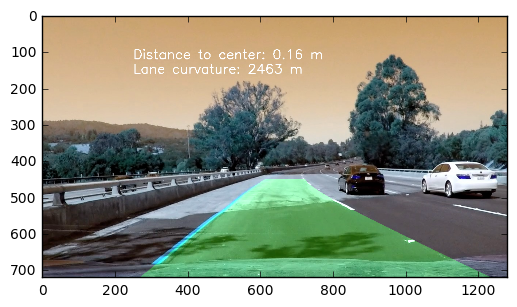

In [27]:
def process_img(img):
    """
    This function executes all the necessary functions 
    to find the lanes and overlay the extra info with 
    the curvature and the distance from the center.
    
    This function is used to generate all the frames
    in the video.
    """
    img_undist = cv2.undistort(img, mtx, dist, None, mtx)
    img_warp, M, Minv = warp(img_undist, mtx, dist)
    binary_warped = multi_thresholds(img_warp)
    leftx, lefty, left_fit, rightx, righty, right_fit = find_lane_points(binary_warped)
    img_lane = cast_lane(img, Minv, left_fit, right_fit)
    curv_left = get_curvature(left_fit, lefty)
    curv_right = get_curvature(right_fit, righty)
    lane_curvature = (curv_left + curv_right) / 2    
    car_position = get_position(leftx[0], rightx[0])
    font = cv2.FONT_HERSHEY_SIMPLEX
    text = "Distance to center: {:.2f} m".format(car_position)
    text2 = "Lane curvature: {} m".format(int(lane_curvature))
    cv2.putText(img_lane,text, (250, 120), font, 1.2, (255, 255, 255), 2)
    cv2.putText(img_lane,text2, (250, 160), font, 1.2, (255, 255, 255), 2)        
    return img_lane

def test_process_img(filename):
    img = cv2.imread(filename)    
    img_lane = process_img(img)
    plt.imshow(img_lane);

test_process_img('test_images/test4.jpg')

In [28]:
white_output = 'project_video_out.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_img)
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video project_video_out.mp4
[MoviePy] Writing video project_video_out.mp4


100%|█████████▉| 1260/1261 [05:04<00:00,  4.28it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_out.mp4 

CPU times: user 8min 44s, sys: 47.9 s, total: 9min 32s
Wall time: 5min 6s


In [30]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))

## 9. The final code

As I said in the beginning of this document, this were the steps to test each step, find good values for necessary parameters, and double check everything. After that, a new code was written, using OOP classes, and some extra features like smoothing the detection using the information from previous frames.

The used classes in the final code are:

- `Camera`: This is the class used to perform the calibration, undistortion and thresholding processes to each image.
- `Lanes`: This class is used to detect the lanes when a warped binary image is given. 
- `Line`: This is used for the `left` and `right` lane in the `Lanes` class, and calculates the curvature, the position and accumulates the information from the previous frames.

Some other features were started, as a quicker version of the `find_lane_points`, using the previous second degree polynomial, but the results weren't satisfactory, and the final version doesn't use it. The function is called `fast_find_lane_points` and can be found in the `lanes.py` file.

